## Object Detection
* Detiction은 인식과 어디에 있늕 까지 알아야하는것!
* 상업적으로 가장 성공한 분야는 얼굴 인식!
* 얼굴인식과 : 누군지 마추는것, 디텍션은 어디에 있지?를 고민
* Object를 찾아야 하는데 어렵다
* 풀스캔하고 이미지를 줄여나가야하는 (최소 약 10만번은해야함, 속도 문제) 
* Detection은 속도의 문제, 모든 크기 모든 회전 모든 위치에 마다 검출하는 것 가능하나 매우 느린 것이 문제!
* 속도를 빠르게 하기 위해서는 20만번동안 얼굴이냐 아니냐를 보는데, 얼굴이냐 아니냐 10만번으로 줄이거나(그러나 CNN으로 10만번 여전히 문제, 0.1초 10만번, 실시간처리에 문제)
* 핸드폰 카메라의 얼굴인식은 Facial Haar feature를 사용해 찾는다. 커널 크기가 임의이며 +1, -1 밖에없다. 다 더하거나 빼거나, (Haar lie feature)
* 간단한 문제로 복잡한 문제를 풀자(MLP처럼), 
* ada boost(에이다 부스다) : 앙상블을 쓸 때 파라미터 중에 soft(평소 신뢰가 가니 너의 의견을 70%, 10% 등 가중치 부여)와 hard(여러 결정을 하는데 voting방식을 사용)
* ada boost등의 간단한 분류기로 검출을 해보자
* casacade decision process : 
    * 단계를 거칠때마다 더 많은 피처를 통해 성공
    * asacade니까 단계단계 폭포수 모델
    * 얼굴이 아닌것은 배경으로 만들어 사용
* Histogram of Oriented Gradients(HOG)
    * Histogram : count, oriented : 방향성 Gradient 방향의 방향성(즉 edge), edge의 방향성에 대한 히스토그램으로 사람인지 아닌지 확인하겠다, 분류기가 들어간다. Haar like의 false alarm이 많아서 나옴
    * (10,20)    
      (50,100) 이라면 방향성은 (10,40) -->편차 ||invert(^) 편차 이것을 단일 각도로 표현할수 있다. 따라서 0도 짜리 몇개, 10도 짜리 몇개 이렇게 count를 함, 사람의 방향성을 갖게 된다.
    * 방향과 magnitude가 있다. 
    * CCTB 사람 검출용, 거리에 몇명있나 등 마케팅 용도 사용

In [2]:
import cv2, numpy as np
import math
import time
import random
from matplotlib import pyplot as plt
%matplotlib inline
from bokeh.plotting import figure
from bokeh.io import output_notebook, show, push_notebook


output_notebook()


def imshow(tit, image) :
    plt.title(tit)    
    if len(image.shape) == 3 :
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    else :
        plt.imshow(image, cmap="gray")
    plt.show()
    
    
def create_win(frames, scale=1.0) :    
    global myImage
    
    all = []
    for f in frames :
        if len(f.shape ) !=  3 : f = cv2.cvtColor(f, cv2.COLOR_GRAY2BGR)
        all.append(f)
    frame = np.vstack(all)
    
    fr=cv2.cvtColor(frame, cv2.COLOR_BGR2RGBA) # because Bokeh expects a RGBA image
    fr=cv2.flip(fr, -1) # because Bokeh flips vertically
    width=fr.shape[1]
    height=fr.shape[0]    

    p = figure(x_range=(0,width), y_range=(0,height), output_backend="webgl", width=int(width*scale), height=int(height*scale))    
    myImage = p.image_rgba(image=[fr], x=0, y=0, dw=width, dh=height)
    show(p, notebook_handle=True)   
    
    
def update_win(frames) :
    
    all = []
    for f in frames :
        if len(f.shape ) !=  3 : f = cv2.cvtColor(f, cv2.COLOR_GRAY2BGR)
        all.append(f)
    frame = np.vstack(all)
    
    fr=cv2.cvtColor(frame, cv2.COLOR_BGR2RGBA)
    fr=cv2.flip(fr, -1)
    myImage.data_source.data['image']=[fr]
    push_notebook()


Loading BokehJS ...

In [52]:
# 동영상 반전 해결
import cv2, numpy as np
import math
import time
import random
from matplotlib import pyplot as plt
%matplotlib inline
from bokeh.plotting import figure
from bokeh.io import output_notebook, show, push_notebook


output_notebook()


def imshow(tit, image) :
    plt.title(tit)    
    if len(image.shape) == 3 :
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    else :
        plt.imshow(image, cmap="gray")
    plt.show()
    
    
def create_win(frames, scale=1.0) :    
    global myImage
    
    all = []
    for f in frames :
        if len(f.shape ) !=  3 : f = cv2.cvtColor(f, cv2.COLOR_GRAY2BGR)
        all.append(f)
    frame = np.vstack(all)
    
    fr=cv2.cvtColor(frame, cv2.COLOR_BGR2RGBA) # because Bokeh expects a RGBA image
    fr=cv2.flip(fr, -1) # because Bokeh flips vertically
    width=fr.shape[1]
    height=fr.shape[0]    

    p = figure(x_range=(0,width), y_range=(0,height), output_backend="webgl", width=int(width*scale), height=int(height*scale))    
    myImage = p.image_rgba(image=[fr], x=0, y=0, dw=width, dh=height)
    show(p, notebook_handle=True)   
    
    
def update_win(frames) :
    
    all = []
    for f in frames :
        if len(f.shape ) !=  3 : f = cv2.cvtColor(f, cv2.COLOR_GRAY2BGR)
        all.append(f)
    frame = np.vstack(all)
    
    fr=cv2.cvtColor(frame, cv2.COLOR_BGR2RGBA)
    fr=cv2.flip(fr, 0)    
    myImage.data_source.data['image']=[fr]
    push_notebook()


Loading BokehJS ...

In [3]:
classifier = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')

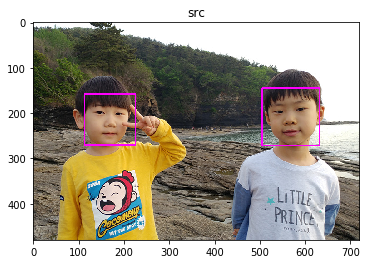

In [4]:
# 얼굴은 패턴이 복잡하지만 공통된 패턴이 있다. 눈의 경우 패턴이 단순
# 따라서 눈이 아닌데 눈이라고 잘못판단할수도(false alarm)
# 눈은 크기보다도 고주파 성분이 너무 없는 것이다.
# 따라서 haar classifier eye.xml을 사용하자!, 아래에 코드 있다.
src = cv2.imread('kids.png')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

In [6]:
src = cv2.imread('dog.jpg')

In [7]:
faces = classifier.detectMultiScale(src)

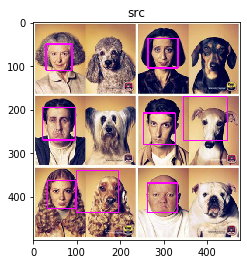

In [8]:
# 굉장히 빠르다.

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

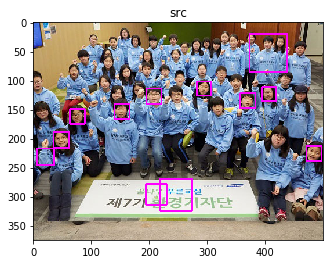

In [9]:
# minimum size가 있어서 못찾는 경우도 있다.
# 핸드폰 카메라도 너무 멀면 안될것이다.
src = cv2.imread('group.jpg')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

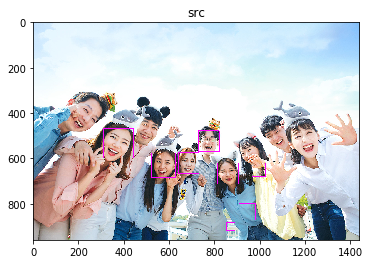

In [10]:
#  Harr like가 회전은 고련하지 않아 찾지 못한다.
src = cv2.imread('group02.jpg')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

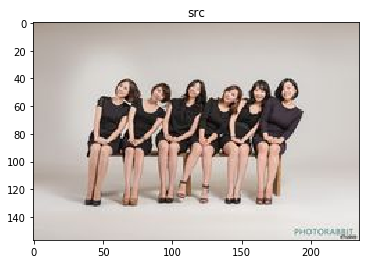

In [11]:
#  Harr like가 회전은 고련하지 않아 찾지 못한다.
src = cv2.imread('group03.jpg')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

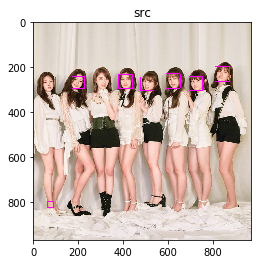

In [12]:
#  Harr like가 회전은 고련하지 않아 찾지 못한다.
src = cv2.imread('group04.jpg')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

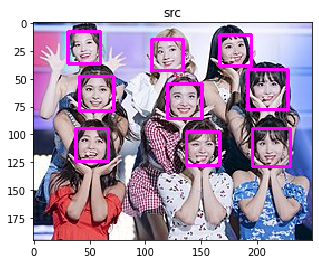

In [13]:
#  Harr like가 회전은 고련하지 않아 찾지 못한다.
src = cv2.imread('group05.jpg')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

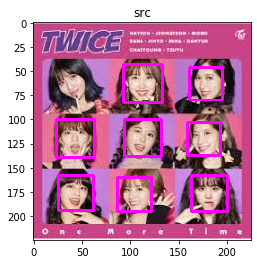

In [14]:
#  Harr like가 회전은 고련하지 않아 찾지 못한다.
src = cv2.imread('group06.jpg')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

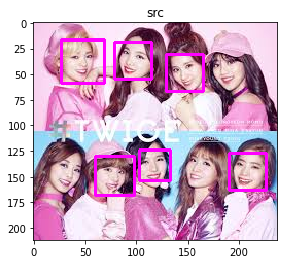

In [15]:
#  Harr like가 회전은 고련하지 않아 찾지 못한다.
src = cv2.imread('group07.jpg')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

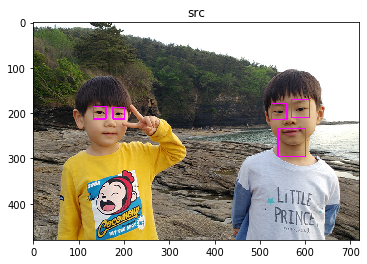

In [17]:
 # 얼굴은 패턴이 복잡하지만 공통된 패턴이 있다. 눈의 경우 패턴이 단순
# 따라서 눈이 아닌데 눈이라고 잘못판단할수도(false alarm)
# 눈은 크기보다도 고주파 성분이 너무 없는 것이다.
# 따라서 haar classifier eye.xml을 사용하자!, 아래에 코드 있다.
classifier = cv2.CascadeClassifier('haarcascade_eye.xml')


src = cv2.imread('kids.png')
faces = classifier.detectMultiScale(src)

for (x, y, w, h) in faces:
    cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)
imshow('src', src)    

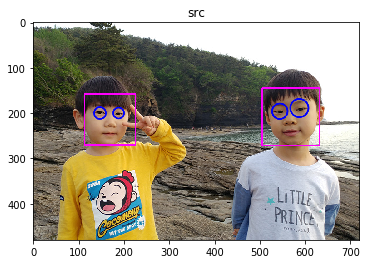

In [19]:
 # 얼굴은 패턴이 복잡하지만 공통된 패턴이 있다. 눈의 경우 패턴이 단순
# 따라서 눈이 아닌데 눈이라고 잘못판단할수도(false alarm)
# 눈은 크기보다도 고주파 성분이 너무 없는 것이다.
# 따라서 haar classifier eye.xml을 사용하자!, 아래에 코드 있다.

# 눈을 감고 찍은것을 알려주거나 여려 사람들이 찍을때 가장 눈을 안감은 사진을 리턴하는 방식으로 사용한다.
face_classifier = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
eye_classifier = cv2.CascadeClassifier('haarcascade_eye.xml')

src = cv2.imread('kids.png')

faces = face_classifier.detectMultiScale(src)

for (x1, y1, w1, h1) in faces:
        cv2.rectangle(src, (x1, y1), (x1 + w1, y1 + h1), (255, 0, 255), 2)

        faceROI = src[y1:y1 + h1, x1:x1 + w1] # 행렬로 접근하기에 거꾸로 나온것처럼 보임
        eyes = eye_classifier.detectMultiScale(faceROI)

        for (x2, y2, w2, h2) in eyes:
            center = (int(x2 + w2 / 2), int(y2 + h2 / 2)) # 정사각형, YOLO는 정사각형 아닌것도,(획기적)
            cv2.circle(faceROI, center, int(w2 / 2), (255, 0, 0), 2, cv2.LINE_AA)

imshow('src', src)  

In [ ]:
 # 얼굴은 패턴이 복잡하지만 공통된 패턴이 있다. 눈의 경우 패턴이 단순
# 따라서 눈이 아닌데 눈이라고 잘못판단할수도(false alarm)
# 눈은 크기보다도 고주파 성분이 너무 없는 것이다.
# 따라서 haar classifier eye.xml을 사용하자!, 아래에 코드 있다.

# 눈을 감고 찍은것을 알려주거나 여려 사람들이 찍을때 가장 눈을 안감은 사진을 리턴하는 방식으로 사용한다.
face_classifier = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
eye_classifier = cv2.CascadeClassifier('haarcascade_eye.xml')

src = cv2.imread('kids.png')

faces = face_classifier.detectMultiScale(src)

for (x1, y1, w1, h1) in faces:
        cv2.rectangle(src, (x1, y1), (x1 + w1, y1 + h1), (255, 0, 255), 2)

        # 영상을 10분의 1로 줄이고 다시 복원하면 모자이크 효과.(?)
        # 2로 나누면 오검출률이 줄어든다.(면적도 줄어들어 속도도 빨라진다.) 단점은 눈을 못검출할수도.
        faceROI = src[y1:y1 + h1/2 , x1:x1 + w1] # 행렬로 접근하기에 거꾸로 나온것처럼 보임
        eyes = eye_classifier.detectMultiScale(faceROI)

        for (x2, y2, w2, h2) in eyes:
            center = (int(x2 + w2 / 2), int(y2 + h2 / 2)) # 정사각형, YOLO는 정사각형 아닌것도,(획기적)
            cv2.circle(faceROI, center, int(w2 / 2), (255, 0, 0), 2, cv2.LINE_AA)

imshow('src', src)  

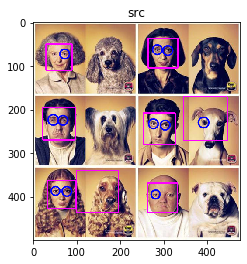

In [20]:
 # 얼굴은 패턴이 복잡하지만 공통된 패턴이 있다. 눈의 경우 패턴이 단순
# 따라서 눈이 아닌데 눈이라고 잘못판단할수도(false alarm)
# 눈은 크기보다도 고주파 성분이 너무 없는 것이다.
# 따라서 haar classifier eye.xml을 사용하자!, 아래에 코드 있다.

# 눈을 감고 찍은것을 알려주거나 여려 사람들이 찍을때 가장 눈을 안감은 사진을 리턴하는 방식으로 사용한다.
face_classifier = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
eye_classifier = cv2.CascadeClassifier('haarcascade_eye.xml')

src = cv2.imread('dog.jpg')

faces = face_classifier.detectMultiScale(src)

for (x1, y1, w1, h1) in faces:
        cv2.rectangle(src, (x1, y1), (x1 + w1, y1 + h1), (255, 0, 255), 2)

        faceROI = src[y1:y1 + h1, x1:x1 + w1] # 행렬로 접근하기에 거꾸로 나온것처럼 보임
        eyes = eye_classifier.detectMultiScale(faceROI)

        for (x2, y2, w2, h2) in eyes:
            center = (int(x2 + w2 / 2), int(y2 + h2 / 2)) # 정사각형, YOLO는 정사각형 아닌것도,(획기적)
            cv2.circle(faceROI, center, int(w2 / 2), (255, 0, 0), 2, cv2.LINE_AA)

imshow('src', src)  

## hog
* full body에 대해서 검출을 한다.

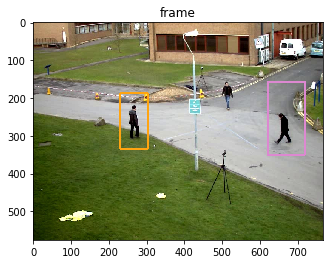

In [25]:
hog = cv2.HOGDescriptor()
# svm은 최전선의 것을 분류하는 전체 데이터의 10%정도, 따라서 오래걸리지 않아 hog안에 들어가 있다?
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())

frame = cv2.imread("people.jpg")
detected, _ = hog.detectMultiScale(frame)

for (x, y, w, h) in detected:
        # 랜덤으로 생상을 선택
        c = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
        cv2.rectangle(frame, (x, y), (x + w, y + h), c, 3)

imshow('frame', frame)

## 나중에 CNN하고 비교를 해보자

In [ ]:
ret,frame = cap.read() # 1번째 프레임 읽어오는 것
ret,frame = cap.read() # 2번째 프레임 읽어오는 것
ret,frame = cap.read() # 3번째 프레임 읽어오는 것

#이것이 아래처럼변함
for i in range(20):
    ret, frame = cap.read()
    
# 쥬피터 노트북으로는 동영상 재생이 어렵기에 위에 함수를 따로 만들어 두었다.

In [26]:
create_win([frame], scale=0.5)

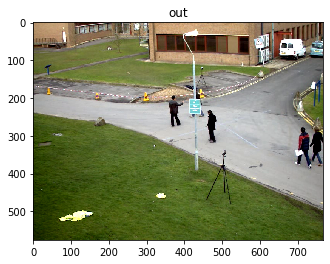

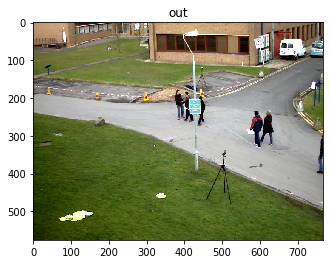

In [37]:
# 강사님

cap = cv2.VideoCapture('vtest.avi')
for i in range(20) :
    ret, frame = cap.read()
    
imshow("out", frame)

for i in range(20) :
    ret, frame = cap.read()

imshow("out", frame)
    
create_win([frame], scale=0.5) 

for i in range(300) :
    ret, frame = cap.read()
    update_win([frame])
    

In [43]:
# 강사님
cap = cv2.VideoCapture('vtest.avi')

for i in range(300) :
    ret, frame = cap.read()
    if i == 0 : 
        create_win([frame], 0.5)
    if not ret:
        break
    
    detected, _ = hog.detectMultiScale(frame)
    
    for (x, y, w, h) in detected:
        # 랜덤으로 생상을 선택
        c = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
        cv2.rectangle(frame, (x, y), (x + w, y + h), c, 3)
        
    update_win([frame])

In [46]:
cap = cv2.VideoCapture('video01.mp4')

for i in range(1000) :
    ret, frame = cap.read()
    if i == 0 : 
        create_win([frame], 0.5)
    if not ret:
        break
    
    detected, _ = hog.detectMultiScale(frame)
    
    for (x, y, w, h) in detected:
        # 랜덤으로 생상을 선택
        c = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
        cv2.rectangle(frame, (x, y), (x + w, y + h), c, 3)
        
    update_win([frame])

KeyboardInterrupt: 

In [ ]:
cap = cv2.VideoCapture('video01.mp4')

classifier = cv2.CascadeClassifier('haarcascade_eye.xml')

for i in range(300) :
    ret, frame = cap.read()
    if i == 0 : 
        create_win([frame], 0.5)
    if not ret:
        break
    
    detected, _ = hog.detectMultiScale(frame)
    
    for (x, y, w, h) in detected:
        # 랜덤으로 생상을 선택
        c = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
        cv2.rectangle(frame, (x, y), (x + w, y + h), c, 3)
        
    update_win([frame])

In [47]:
cap = cv2.VideoCapture('english.mp4')

for i in range(300) :
    ret, frame = cap.read()    
    if i == 0 : 
        create_win([frame], 0.5)
    if not ret:
        break

        
    faces = classifier.detectMultiScale(frame)

    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 255), 2)
        
    update_win([frame])            
    

KeyboardInterrupt: 

In [53]:
cap = cv2.VideoCapture('video01.mp4')

for i in range(3000) :
    ret, frame = cap.read()    
    if i == 0 : 
        create_win([frame], 0.5)
    if not ret:
        break

        
    faces = classifier.detectMultiScale(frame)

    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 255), 2)
        
    update_win([frame])            
    

KeyboardInterrupt: 

In [55]:
cap = cv2.VideoCapture('video02.mp4')

for i in range(10000) :
    ret, frame = cap.read()    
    if i == 0 : 
        create_win([frame], 0.5)
    if not ret:
        break

        
    faces = classifier.detectMultiScale(frame)

    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 255), 2)
        
    update_win([frame])            
    

회전점등은 어떻게 검출할 것인가.
* orb, sift와같은 특징점을 찾는 것이 중요
* object recognization + object detection(어떻게 찾을 것인가.)